# Python and OOI hydrophone data
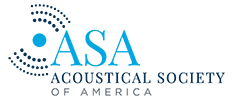

**Virtual Meeting, Fall 2024**

## Environment setup for this notebook

In this section of the notebook, I'll walk you through setting up a python environment for this notebook. It's not necessary to use this exact configuration. These instructions were written for a UNIX based system (Mac or Linux). Some of instructions are likely different for a windows system.

I use miniconda as my package manager. You can install it [here](https://docs.anaconda.com/miniconda/miniconda-install/)

- creata a new miniconda environment
```console
conda create -n ooi
```
- activate the new conda environment
```console
conda activate ooi
```
- When the environment is activated, you should see the environment name in the console. It should look something like this:
```
(ooi) John@<computer name> ~ %
```
- install python and the the packages that this notebook uses
```console
conda install python numpy matplotlib scipy pandas seaborn hvplot
```
- install xarray. Xarray has several backends that aren't strict dependancies but increase the functionality of the python package. We'll use some of these later in the notebook. For more information about installing xarray, see the [install section of xarray docs](https://docs.xarray.dev/en/latest/getting-started-guide/installing.html). I've added zarr to the default backends listed in the docs section, which we'll use later in notebook
```console
conda install -c conda-forge xarray dask netCDF4 bottleneck zarr
```
- install ooipy
```console
pip install ooipy
```
- install jupyter-lab to be able to open and edit the notebook.
```console
conda install -c conda-forge jupyterlab
pip install dask-labextension
```
You should now have a conda environment named ooi, with all of the packages that we need for this notebook. You can double check that which packages you have installed with the command:
```console
conda list
```
If you want to open the notebook on your own computer and run the code, you can run jupyter lab, which should open on your web browser
```console
jupyter lab
```

## Overview of ooipy

<img src="https://ooipy.readthedocs.io/en/latest/_images/OOIPY_Logo.png" width="100">

[ooipy](https://github.com/Ocean-Data-Lab/ooipy) is a python package designed to help access hydrophone data from the Ocean Observatories Initiative (OOI) cabled ocean observatory. OOI hydrophone data is all open access, and is a great opportunity for educational exercises and conducting novel research. 



ooipy is a community backed, open source python package that is a stand in for an API to access OOI hydrophone data.

In [1]:
import ooipy
from datetime import datetime
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import pandas as pd
from IPython.display import Audio
import seaborn as sns
import hvplot.xarray

%config InlineBackend.figure_format='retina'

### download hydrophone data within python environment

In [2]:
starttime=datetime(2019,1,12,3)
endtime=datetime(2019,1,12,3,2)
node = 'LJ01C'

hdata = ooipy.get_acoustic_data(starttime, endtime, node, verbose=True)

Fetching URLs...
Sorting valid URLs for Time Window...


100%|█████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Merging 4 Traces...
Data has Gaps


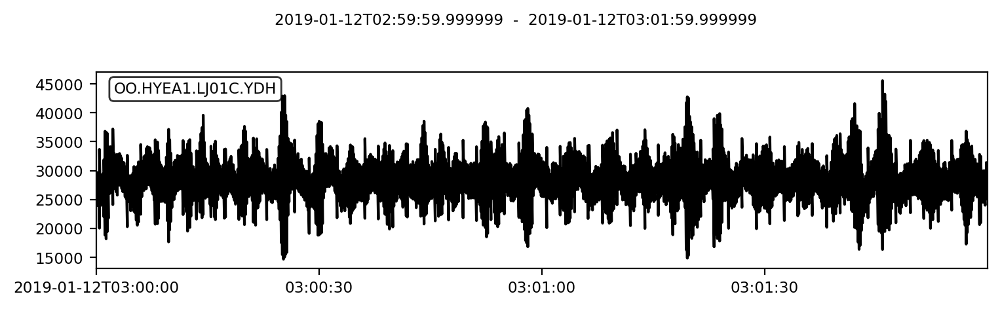

In [7]:
_ = hdata.plot()

In [8]:
psd = hdata.compute_psd_welch()

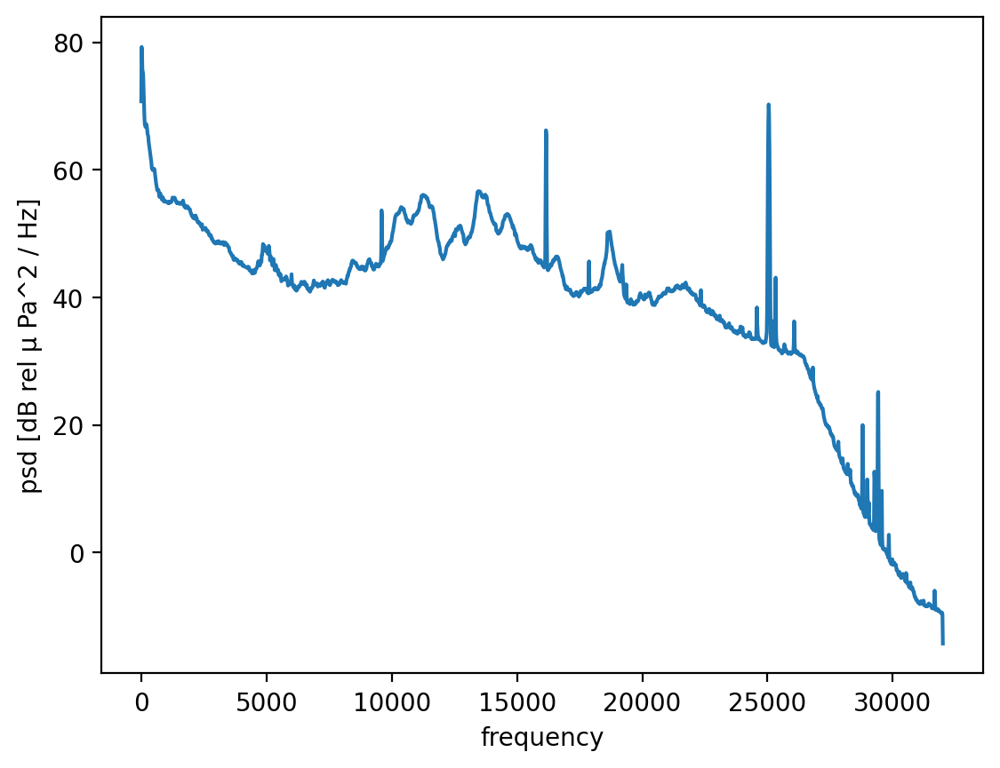

In [10]:
psd.plot()

In [11]:
hdata_norm = (hdata.data - np.mean(hdata.data))
hdata_norm = hdata_norm / np.max(hdata_norm)

In [12]:
Audio(hdata_norm[64000*45:64000*60], rate=64000)

In [13]:
spec = hdata.compute_spectrogram(avg_time=0.08, L=2048)
spec.frequency.attrs['units'] = 'Hz'

In [15]:
spec.hvplot.image(x='time', cmap='rocket',clim=(40,90))

:Image   [time,frequency]   (spectrogram)

In [16]:
hdata.save('mat', 'humpback')

### Batch downloading from terminal / command line

ooipy also comes with a program that can batch download data specified by a csv file. This would be useful if you want to use different software (other than python) to analyze your acoustic data.

Some of the features of this are still under development, but a simple working example is provided below. If you run into a use case that you would like that currently isn't working, I'd encourage you to [submit an issue](https://github.com/Ocean-Data-Lab/ooipy/issues) on GitHub and consider contributing as well.

- included in the repository is the file batch_download.csv
- In the terminal type
```console
download_hydrophone_data -h
```
- this should give you the documentation of the program. Now in the command line, navigate to the directory that your csv file is saved and run the program with:
```console
download_hydrophone_data --csv batch_download.csv --output_path .
```
This specifies the csv path and the path to download the files (`.` specifies to download the files in the current directory)

## Spectral Statistical Analysis using xarray
***playing around with big(ish) data***

<img src="https://docs.xarray.dev/en/stable/_static/Xarray_Logo_RGB_Final.svg" width="500">

**xarray** is a great tool for scientific data analysis that combines the concept of the n-dimensional array (like a numpy.array) and labeled coordinates the data. It came out of the earth / space science community, but is relevant to acoustic data though as well.

Learning all of the ins and outs of xarray is beyond the scope of this demo, but there exists some great resources to learn more about xarray. Specifically, [this chapter](https://earth-env-data-science.github.io/lectures/xarray/xarray_intro.html) of the book **Earth and Environmental Data Science** [book link](https://earth-env-data-science.github.io/intro.html) does a great job of going over some of the capabilities of xarray in more detail.

<img src="http://xarray.pydata.org/en/stable/_images/dataset-diagram.png" width="700">

**Downloading the data for this section**
The spectrograms that we use in this section are about 1.5 GB, and can be downloaded from zenodo. Follow the link below and download the zip file into the current directory. Then unzip the file. You should see a folder named `lf_specs.zarr`.

[https://doi.org/10.5281/zenodo.14048118](https://doi.org/10.5281/zenodo.14048118)


- zarr files are a nice way to store large datasets that enable larger than memory calculations
- all of the details of utilizing zarr and dask arrays is beyond the scope of this presentation, but [this chapter](https://earth-env-data-science.github.io/lectures/dask/intro.html#) of the same book does a great job of explaining it.

In [17]:
import xarray as xr
from dask.distributed import LocalCluster, Client
import hvplot.xarray
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [18]:
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 11
Total threads: 11,Total memory: 18.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:61785,Workers: 11
Dashboard: http://127.0.0.1:8787/status,Total threads: 11
Started: Just now,Total memory: 18.00 GiB
Comm: tcp://127.0.0.1:61812,Total threads: 1
Dashboard: http://127.0.0.1:61822/status,Memory: 1.64 GiB
Nanny: tcp://127.0.0.1:61788,


In [19]:
fn = 'lf_specs.zarr'
ds = xr.open_zarr(fn)

#### visualize spectrogram

In [23]:
ds['central_caldera'].hvplot.image(x='time', rasterize=True, cmap='rocket', clim=(50,90), ylim=(0,90))

:DynamicMap   []
   :Image   [time,frequency]   (central_caldera)

### Spectral Quantiles

In [24]:
frequency_quantiles = ds.chunk({'time': -1}).quantile(np.arange(0.1,1,0.1), dim='time')

In [26]:
frequency_quantiles = frequency_quantiles.compute()

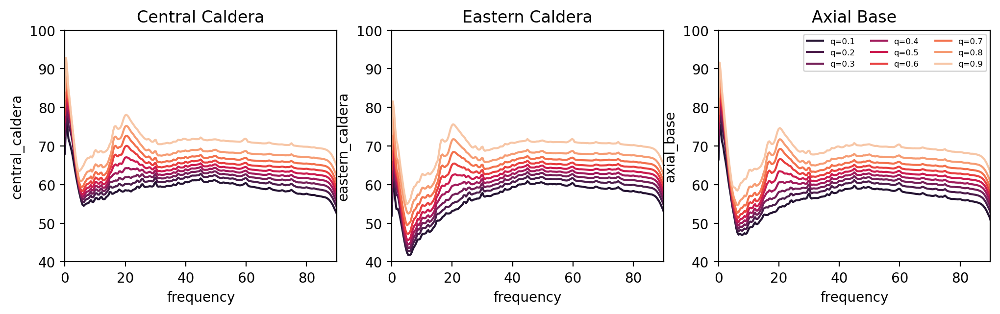

In [27]:
sns.set_palette('rocket',9)

fig = plt.figure(figsize=(10,3))

plt.subplot(1,3,1)
# central Caldera
for k in range(9):
    frequency_quantiles['central_caldera'][k,:].plot(label=f'q={float(frequency_quantiles.coords['quantile'][k]):0.2}')
#plt.legend(ncols=4)
plt.xlim(0,90)
plt.ylim([40,100])
plt.title('Central Caldera')

plt.subplot(1,3,2)
# Eastern Caldera
for k in range(9):
    frequency_quantiles['eastern_caldera'][k,:].plot(label=f'q={float(frequency_quantiles.coords['quantile'][k]):0.2}')
plt.xlim(0,90)
plt.ylim([40,100])
plt.title('Eastern Caldera')

plt.subplot(1,3,3)
# Axial Base
for k in range(9):
    frequency_quantiles['axial_base'][k,:].plot(label=f'q={float(frequency_quantiles.coords['quantile'][k]):0.2}')
plt.xlim(0,90)
plt.ylim([40,100])
plt.title('Axial Base')

plt.legend(ncols=3, fontsize=6)
plt.tight_layout(pad=0)

### Integrating over frequency band

In [28]:
f_band1 = (20*np.log10((10**(ds/20)).sel({'frequency':slice(15,25)}).integrate('frequency')))
f_band2 = (20*np.log10((10**(ds/20)).sel({'frequency':slice(50,60)}).integrate('frequency')))

In [32]:
f_band1_month = f_band1.resample({'time':'ME'})
f_band2_month = f_band2.resample({'time':'ME'})

#f_band1_month = f_band1.resample({'time':'d'})
#f_band2_month = f_band2.resample({'time':'d'})

In [33]:
f_band1_mean = f_band1_month.mean().compute()
f_band1_std = f_band1_month.std().compute()

f_band2_mean = f_band2_month.mean().compute()
f_band2_std = f_band2_month.std().compute()

/opt/miniconda3/envs/ooi/lib/python3.12/site-packages/dask/array/numpy_compat.py:57: RuntimeWarning: invalid value encountered in divide
  x = np.divide(x1, x2, out)
/opt/miniconda3/envs/ooi/lib/python3.12/site-packages/dask/array/numpy_compat.py:57: RuntimeWarning: invalid value encountered in divide
  x = np.divide(x1, x2, out)


Text(0.5, 1.0, '20Hz band for different locations')

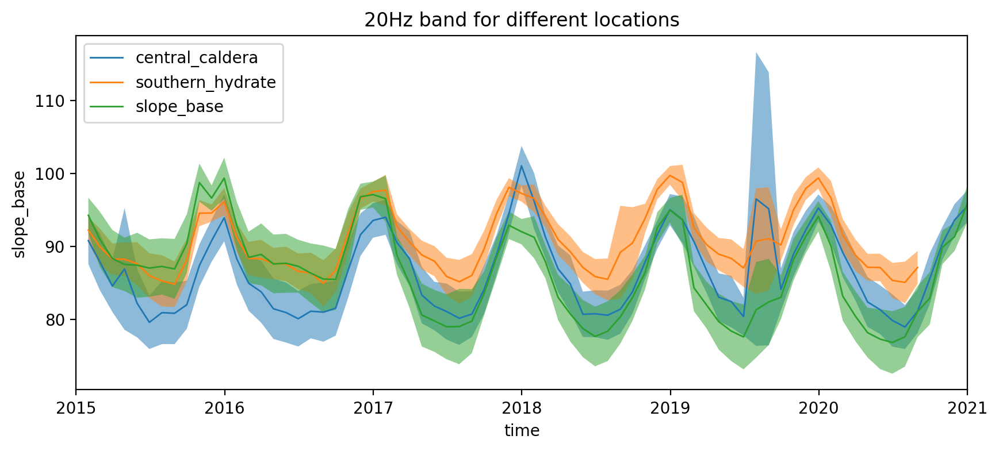

In [34]:
fig = plt.figure(figsize=(10,4))

sns.set_palette('tab10',3)

nodes = ['central_caldera', 'southern_hydrate', 'slope_base']

for node in nodes:
    f_band1_mean[node].plot(lw=1, label=node)
    plt.fill_between(f_band1_mean[node].time, f_band1_mean[node] + f_band1_std[node], f_band1_mean[node] - f_band1_std[node], lw=0, alpha=0.5)

plt.legend()
plt.xlim([pd.Timestamp('2015-01-01'), pd.Timestamp('2021-01-01')])
plt.title('20Hz band for different locations')

Text(0.5, 1.0, '20Hz and 50Hz bands for Central Caldera')

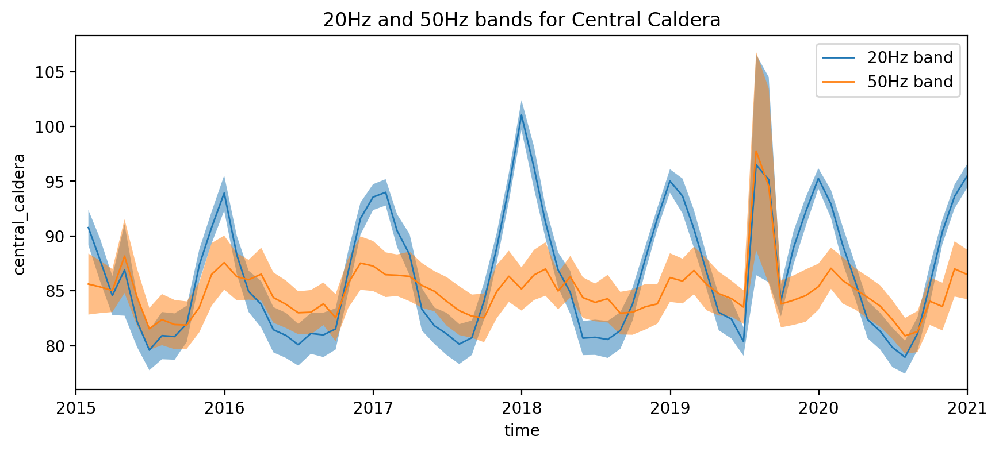

In [35]:
fig = plt.figure(figsize=(10,4))

sns.set_palette('tab10',3)

node = 'central_caldera'

f_band1_mean[node].plot(lw=1, label='20Hz band')
plt.fill_between(f_band1_mean[node].time, f_band1_mean[node] + f_band1_std[node]/2, f_band1_mean[node] - f_band1_std[node]/2, lw=0, alpha=0.5)

f_band2_mean[node].plot(lw=1, label='50Hz band')
plt.fill_between(f_band2_mean[node].time, f_band2_mean[node] + f_band2_std[node]/2, f_band2_mean[node] - f_band2_std[node]/2, lw=0, alpha=0.5)

plt.legend()
plt.xlim([pd.Timestamp('2015-01-01'), pd.Timestamp('2021-01-01')])
plt.title('20Hz and 50Hz bands for Central Caldera')